# Style Transfer with Deep Neural Networks


In this notebook, we’ll *recreate* a style transfer method that is outlined in the paper, [Image Style Transfer Using Convolutional Neural Networks, by Gatys](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf) in PyTorch.

In this paper, style transfer uses the features found in the 19-layer VGG Network, which is comprised of a series of convolutional and pooling layers, and a few fully-connected layers. In the image below, the convolutional layers are named by stack and their order in the stack. Conv_1_1 is the first convolutional layer that an image is passed through, in the first stack. Conv_2_1 is the first convolutional layer in the *second* stack. The deepest convolutional layer in the network is conv_5_4.

<img src='notebook_ims/vgg19_convlayers.png' width=80% />

### Separating Style and Content

Style transfer relies on separating the content and style of an image. Given one content image and one style image, we aim to create a new, _target_ image which should contain our desired content and style components:
* objects and their arrangement are similar to that of the **content image**
* style, colors, and textures are similar to that of the **style image**

An example is shown below, where the content image is of a cat, and the style image is of [Hokusai's Great Wave](https://en.wikipedia.org/wiki/The_Great_Wave_off_Kanagawa). The generated target image still contains the cat but is stylized with the waves, blue and beige colors, and block print textures of the style image!

<img src='notebook_ims/style_tx_cat.png' width=80% />

In this notebook, we'll use a pre-trained VGG19 Net to extract content or style features from a passed in image. We'll then formalize the idea of content and style _losses_ and use those to iteratively update our target image until we get a result that we want. You are encouraged to use a style and content image of your own and share your work on Twitter with @udacity; we'd love to see what you come up with!

In [1]:
# import resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
import requests
from torchvision import transforms, models


## Load in VGG19 (features)

VGG19 is split into two portions:
* `vgg19.features`, which are all the convolutional and pooling layers
* `vgg19.classifier`, which are the three linear, classifier layers at the end

We only need the `features` portion, which we're going to load in and "freeze" the weights of, below.

In [2]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

In [3]:
# move the model to GPU, if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

### Load in Content and Style Images

You can load in any images you want! Below, we've provided a helper function for loading in any type and size of image. The `load_image` function also converts images to normalized Tensors.

Additionally, it will be easier to have smaller images and to squish the content and style images so that they are of the same size.

In [4]:
def load_image(img_path, max_size=400, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= 400 pixels in the x-y dims.'''
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

Next, I'm loading in images by file name and forcing the style image to be the same size as the content image.

In [5]:
# load in content and style image
#content = load_image('Mona_Lisa.jpg').to(device)
content = load_image('Dahlia_Bodacious.jpg').to(device)
# Resize style to match content, makes code easier
style = load_image('morefelledtrees_hockney.jpg', shape=content.shape[-2:]).to(device)

In [6]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

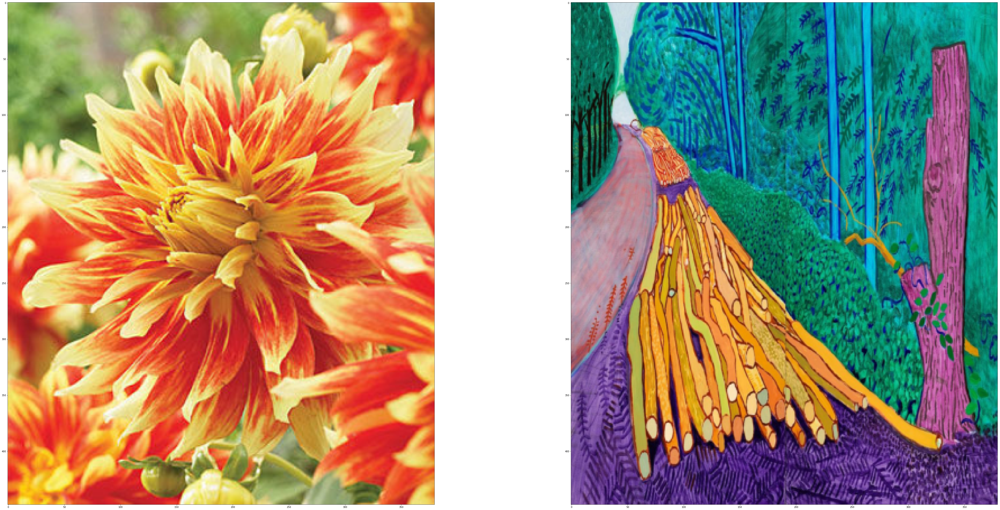

In [7]:
# display the images
#fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(80, 40))
# content and style ims side-by-side
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

---
## VGG19 Layers

To get the content and style representations of an image, we have to pass an image forward throug the VGG19 network until we get to the desired layer(s) and then get the output from that layer.

In [8]:
# print out VGG19 structure so you can see the names of various layers
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

## Content and Style Features

Below, complete the mapping of layer names to the names found in the paper for the _content representation_ and the _style representation_.

In [9]:
def get_features(image, model, layers=None):
    """ Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
    """
    
    ## TODO: Complete mapping layer names of PyTorch's VGGNet to names from the paper
    ## Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1', 
                  '10': 'conv3_1', 
                  '19': 'conv4_1',
                  '21': 'conv4_2',  ## content representation
                  '28': 'conv5_1'}
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

---
## Gram Matrix 

The output of every convolutional layer is a Tensor with dimensions associated with the `batch_size`, a depth, `d` and some height and width (`h`, `w`). The Gram matrix of a convolutional layer can be calculated as follows:
* Get the depth, height, and width of a tensor using `batch_size, d, h, w = tensor.size`
* Reshape that tensor so that the spatial dimensions are flattened
* Calculate the gram matrix by multiplying the reshaped tensor by it's transpose 

*Note: You can multiply two matrices using `torch.mm(matrix1, matrix2)`.*

In [10]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # get the batch_size, depth, height, and width of the Tensor
    _, d, h, w = tensor.size()
    
    # reshape so we're multiplying the features for each channel
    tensor = tensor.view(d, h * w)
    
    # calculate the gram matrix
    gram = torch.mm(tensor, tensor.t())
    
    return gram 

## Putting it all Together

Now that we've written functions for extracting features and computing the gram matrix of a given convolutional layer; let's put all these pieces together! We'll extract our features from our images and calculate the gram matrices for each layer in our style representation.

In [11]:
# get content and style features only once before training
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

# calculate the gram matrices for each layer of our style representation
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

# create a third "target" image and prep it for change
# it is a good idea to start off with the target as a copy of our *content* image
# then iteratively change its style
target = content.clone().requires_grad_(True).to(device)

---
## Loss and Weights

#### Individual Layer Style Weights

Below, you are given the option to weight the style representation at each relevant layer. It's suggested that you use a range between 0-1 to weight these layers. By weighting earlier layers (`conv1_1` and `conv2_1`) more, you can expect to get _larger_ style artifacts in your resulting, target image. Should you choose to weight later layers, you'll get more emphasis on smaller features. This is because each layer is a different size and together they create a multi-scale style representation!

#### Content and Style Weight

Just like in the paper, we define an alpha (`content_weight`) and a beta (`style_weight`). This ratio will affect how _stylized_ your final image is. It's recommended that you leave the content_weight = 1 and set the style_weight to achieve the ratio you want.

In [12]:
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 1.2, # 1.
                 'conv2_1': 1.,# 0.75
                 'conv3_1': 0.2, # 0.2
                 'conv4_1': 0.2, # 0.2
                 'conv5_1': 0.2} # 0.2

content_weight = 1  # alpha
style_weight = 1e6  # beta

## Updating the Target & Calculating Losses

You'll decide on a number of steps for which to update your image, this is similar to the training loop that you've seen before, only we are changing our _target_ image and nothing else about VGG19 or any other image. Therefore, the number of steps is really up to you to set! **I recommend using at least 2000 steps for good results.** But, you may want to start out with fewer steps if you are just testing out different weight values or experimenting with different images.

Inside the iteration loop, you'll calculate the content and style losses and update your target image, accordingly.

#### Content Loss

The content loss will be the mean squared difference between the target and content features at layer `conv4_2`. This can be calculated as follows: 
```
content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
```

#### Style Loss

The style loss is calculated in a similar way, only you have to iterate through a number of layers, specified by name in our dictionary `style_weights`. 
> You'll calculate the gram matrix for the target image, `target_gram` and style image `style_gram` at each of these layers and compare those gram matrices, calculating the `layer_style_loss`. 
> Later, you'll see that this value is normalized by the size of the layer.

#### Total Loss

Finally, you'll create the total loss by adding up the style and content losses and weighting them with your specified alpha and beta!

Intermittently, we'll print out this loss; don't be alarmed if the loss is very large. It takes some time for an image's style to change and you should focus on the appearance of your target image rather than any loss value. Still, you should see that this loss decreases over some number of iterations.

In [13]:
'''

def save_image(image, filename):
    # Ensure the pixel-values are between 0 and 255.
    image = np.clip(image, 0.0, 255.0)
    # Convert to bytes.
    image = image.astype(np.uint8)
    # Write the image-file in jpeg-format.
    with open(filename, 'wb') as file:
        PIL.Image.fromarray(image).save(file, 'jpeg')
        
        
'''

"\n\ndef save_image(image, filename):\n    # Ensure the pixel-values are between 0 and 255.\n    image = np.clip(image, 0.0, 255.0)\n    # Convert to bytes.\n    image = image.astype(np.uint8)\n    # Write the image-file in jpeg-format.\n    with open(filename, 'wb') as file:\n        PIL.Image.fromarray(image).save(file, 'jpeg')\n        \n        \n"

Total loss:  484842592.0
ii:  400


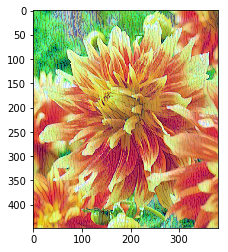

Total loss:  86383072.0
ii:  800


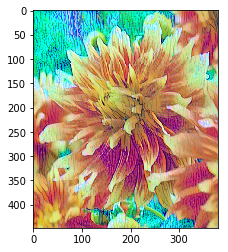

Total loss:  29142968.0
ii:  1200


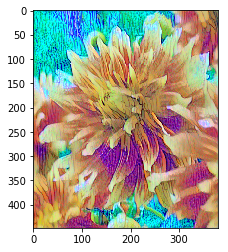

Total loss:  18662322.0
ii:  1600


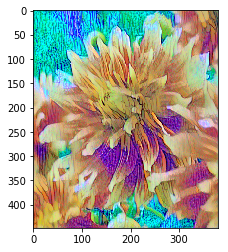

Total loss:  13190595.0
ii:  2000


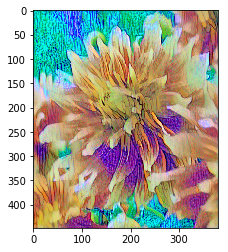

Total loss:  9867290.0
ii:  2400


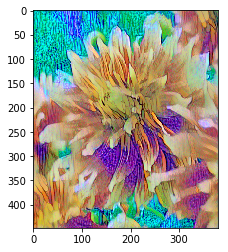

Total loss:  7763942.5
ii:  2800


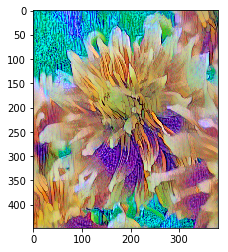

Total loss:  6322936.0
ii:  3200


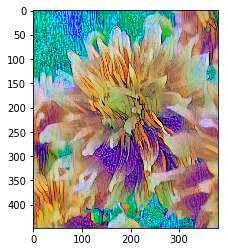

Total loss:  5220111.0
ii:  3600


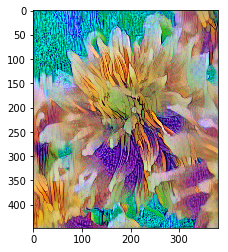

Total loss:  4294457.0
ii:  4000


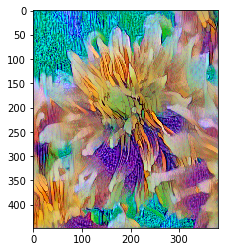

Total loss:  3479112.5
ii:  4400


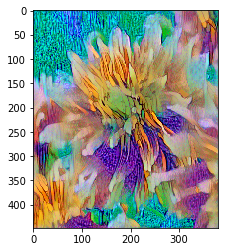

Total loss:  2760363.0
ii:  4800


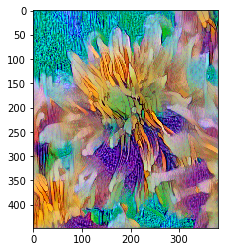

Total loss:  2148531.25
ii:  5200


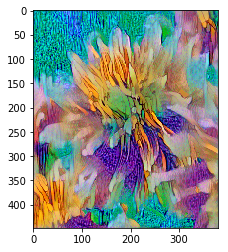

Total loss:  1648715.75
ii:  5600


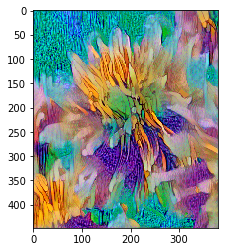

Total loss:  1253597.125
ii:  6000


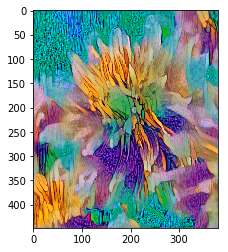

Total loss:  955257.8125
ii:  6400


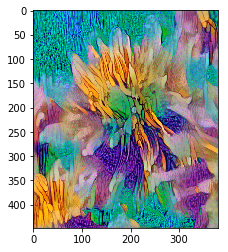

Total loss:  737782.9375
ii:  6800


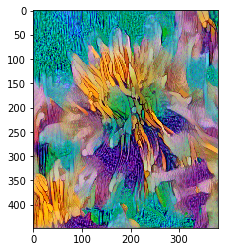

Total loss:  582311.3125
ii:  7200


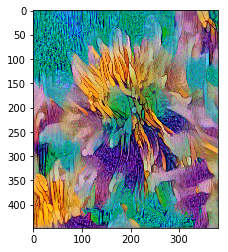

Total loss:  470115.71875
ii:  7600


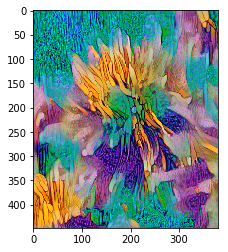

Total loss:  387575.65625
ii:  8000


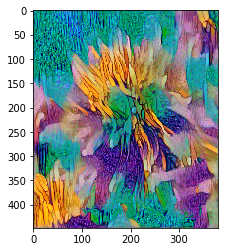

Total loss:  326159.34375
ii:  8400


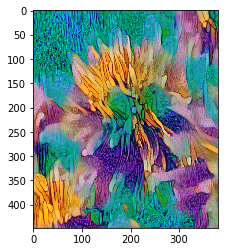

Total loss:  279229.75
ii:  8800


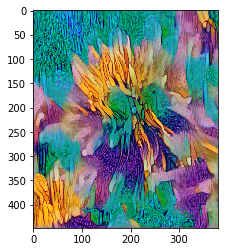

Total loss:  244570.046875
ii:  9200


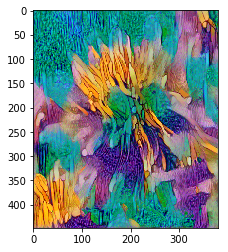

Total loss:  216364.765625
ii:  9600


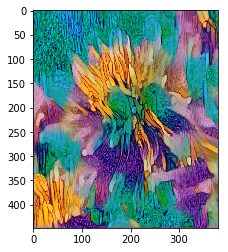

Total loss:  195833.84375
ii:  10000


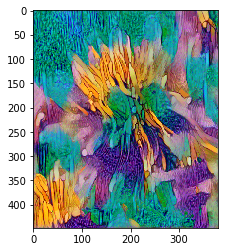

Total loss:  178166.8125
ii:  10400


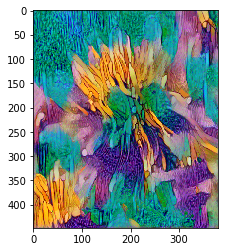

Total loss:  164325.546875
ii:  10800


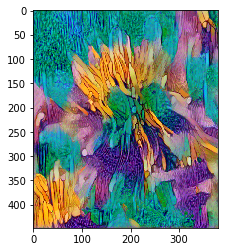

Total loss:  153285.953125
ii:  11200


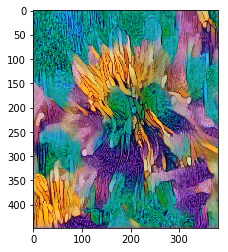

Total loss:  144422.75
ii:  11600


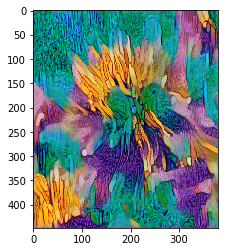

Total loss:  137460.0625
ii:  12000


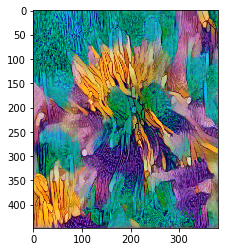

Total loss:  131272.546875
ii:  12400


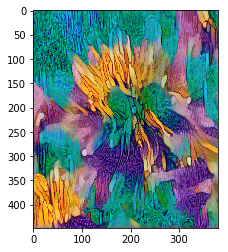

Total loss:  126438.6875
ii:  12800


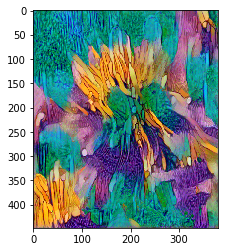

Total loss:  125554.9140625
ii:  13200


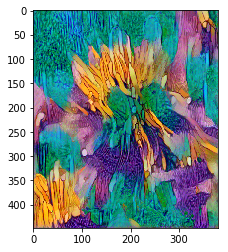

Total loss:  117959.515625
ii:  13600


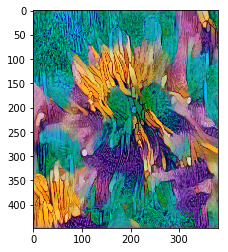

Total loss:  114757.1640625
ii:  14000


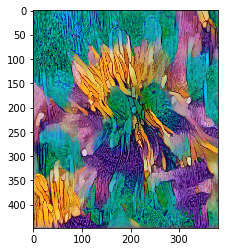

Total loss:  112076.1328125
ii:  14400


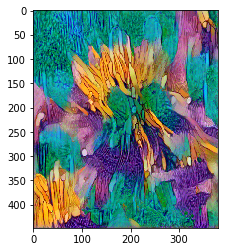

Total loss:  109659.90625
ii:  14800


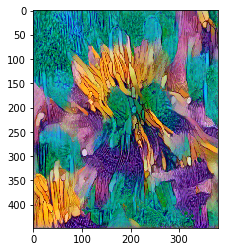

Total loss:  107410.296875
ii:  15200


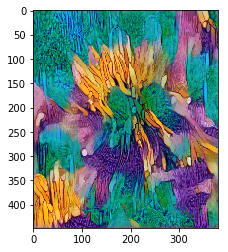

Total loss:  105597.65625
ii:  15600


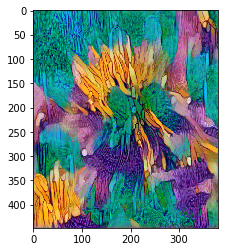

Total loss:  103691.1953125
ii:  16000


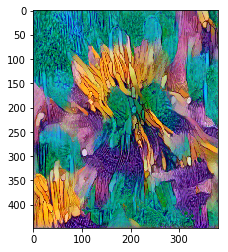

Total loss:  102003.1875
ii:  16400


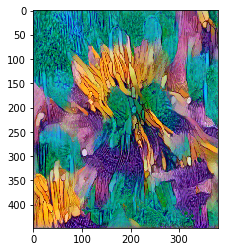

Total loss:  100670.953125
ii:  16800


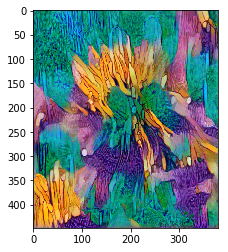

Total loss:  99112.5234375
ii:  17200


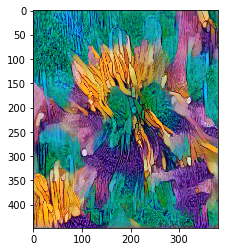

Total loss:  97951.3515625
ii:  17600


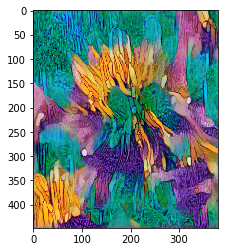

Total loss:  96657.0390625
ii:  18000


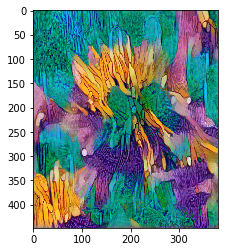

Total loss:  96311.3125
ii:  18400


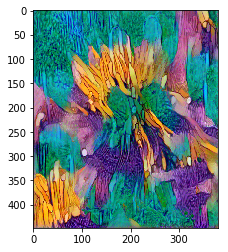

Total loss:  95020.484375
ii:  18800


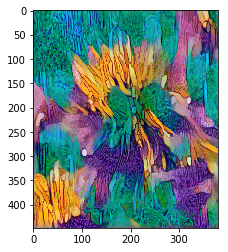

Total loss:  94134.1640625
ii:  19200


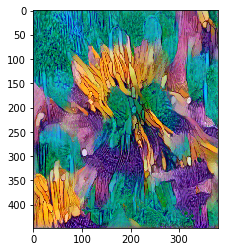

Total loss:  92778.5
ii:  19600


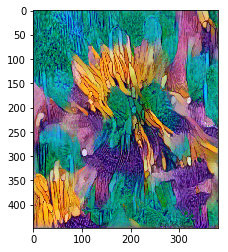

Total loss:  91883.59375
ii:  20000


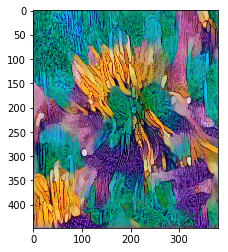

Total loss:  92169.6484375
ii:  20400


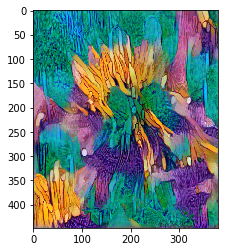

Total loss:  90468.2734375
ii:  20800


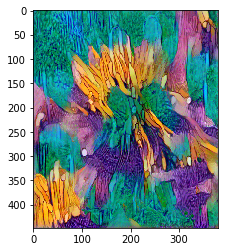

Total loss:  90281.3828125
ii:  21200


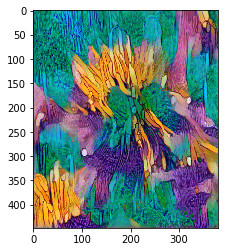

Total loss:  89375.7890625
ii:  21600


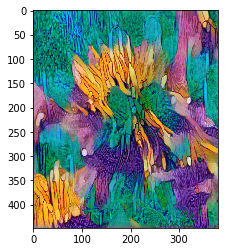

Total loss:  88717.5546875
ii:  22000


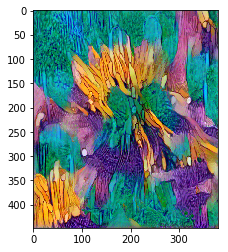

Total loss:  88002.9453125
ii:  22400


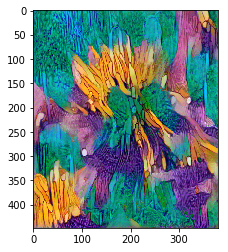

Total loss:  87474.5078125
ii:  22800


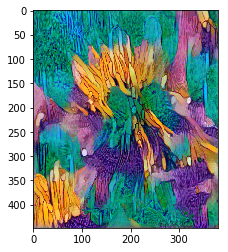

Total loss:  87500.1015625
ii:  23200


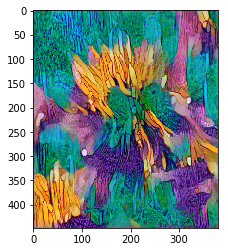

Total loss:  86410.4921875
ii:  23600


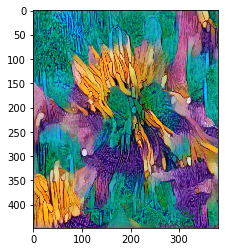

Total loss:  85880.234375
ii:  24000


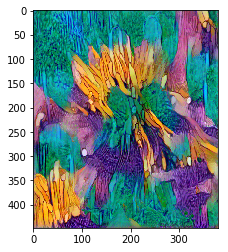

Total loss:  85051.453125
ii:  24400


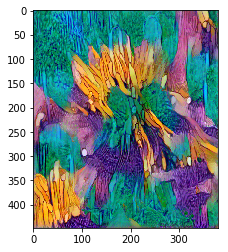

Total loss:  84634.5546875
ii:  24800


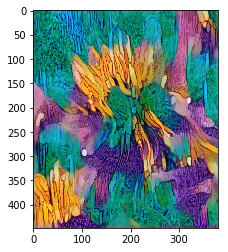

Total loss:  84432.25
ii:  25200


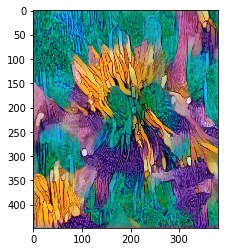

Total loss:  83755.640625
ii:  25600


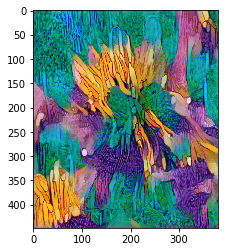

Total loss:  83214.0
ii:  26000


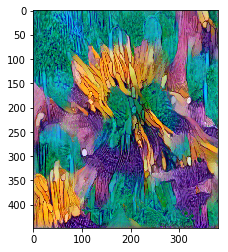

Total loss:  82819.3359375
ii:  26400


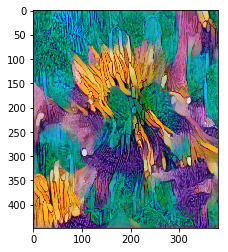

Total loss:  82544.875
ii:  26800


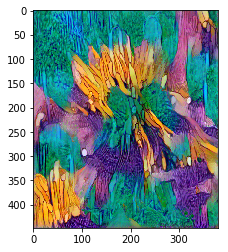

Total loss:  81996.9140625
ii:  27200


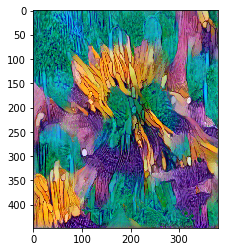

Total loss:  83708.3046875
ii:  27600


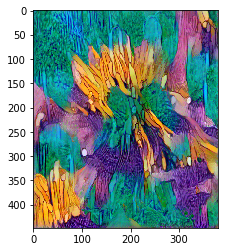

Total loss:  81725.375
ii:  28000


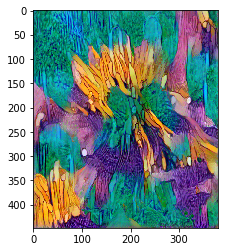

Total loss:  80956.9921875
ii:  28400


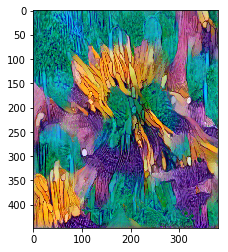

Total loss:  80577.484375
ii:  28800


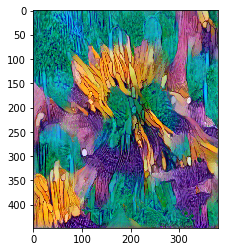

Total loss:  80785.7265625
ii:  29200


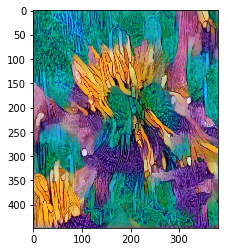

Total loss:  80168.625
ii:  29600


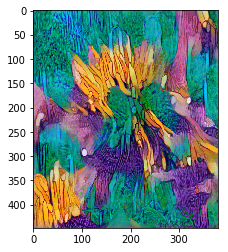

Total loss:  79711.0703125
ii:  30000


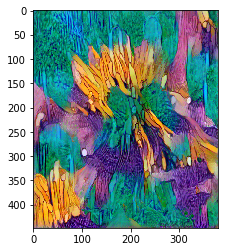

Total loss:  79392.8203125
ii:  30400


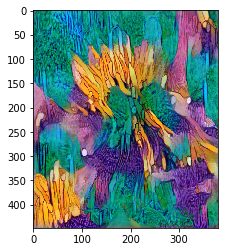

Total loss:  79120.2109375
ii:  30800


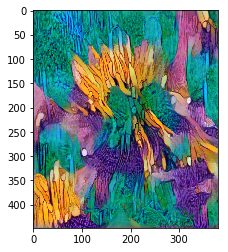

Total loss:  78916.125
ii:  31200


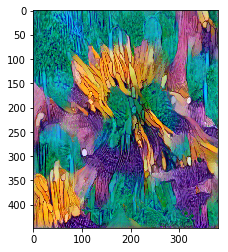

Total loss:  78848.453125
ii:  31600


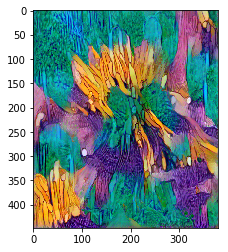

Total loss:  81348.5078125
ii:  32000


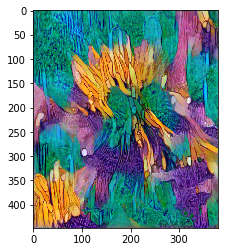

Total loss:  82394.734375
ii:  32400


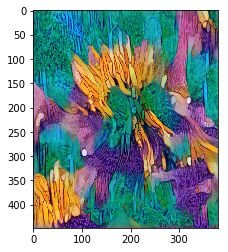

Total loss:  78096.203125
ii:  32800


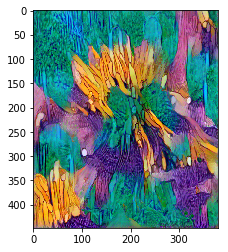

Total loss:  77755.1640625
ii:  33200


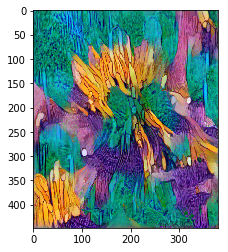

Total loss:  77760.3828125
ii:  33600


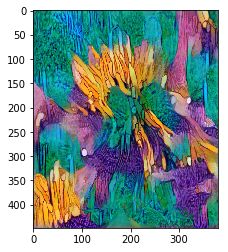

Total loss:  77220.7421875
ii:  34000


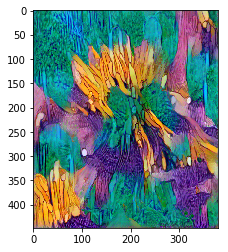

Total loss:  77217.28125
ii:  34400


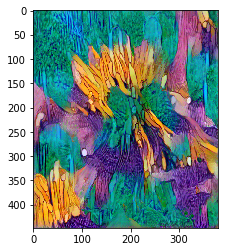

Total loss:  76730.7734375
ii:  34800


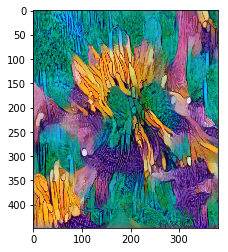

Total loss:  77460.453125
ii:  35200


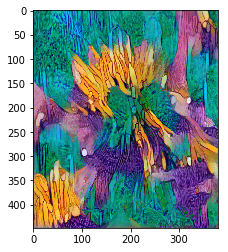

Total loss:  76594.75
ii:  35600


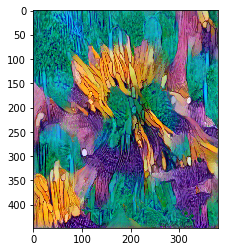

Total loss:  77003.953125
ii:  36000


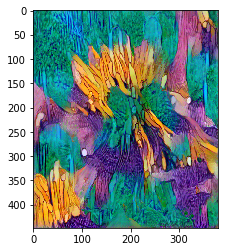

Total loss:  76128.234375
ii:  36400


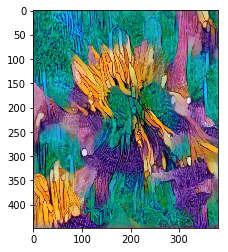

Total loss:  80753.75
ii:  36800


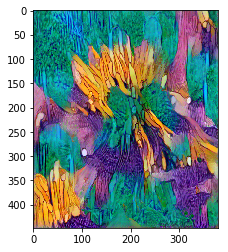

Total loss:  75716.125
ii:  37200


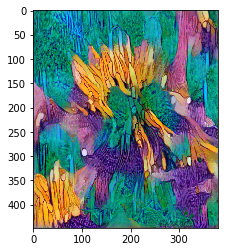

Total loss:  75366.4609375
ii:  37600


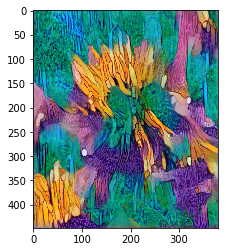

Total loss:  75445.2109375
ii:  38000


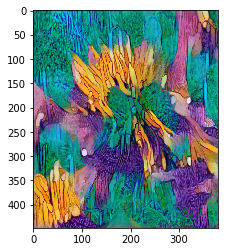

Total loss:  75241.4375
ii:  38400


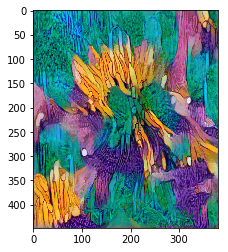

Total loss:  74848.515625
ii:  38800


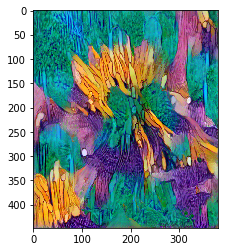

Total loss:  74902.9453125
ii:  39200


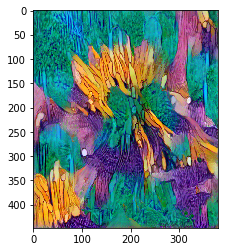

Total loss:  74753.3359375
ii:  39600


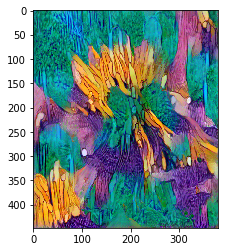

Total loss:  74293.2421875
ii:  40000


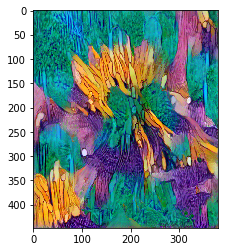

Total loss:  74488.3203125
ii:  40400


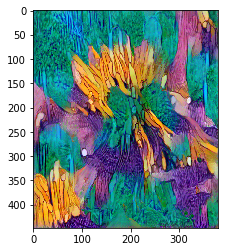

Total loss:  74043.421875
ii:  40800


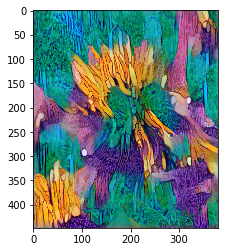

Total loss:  73896.109375
ii:  41200


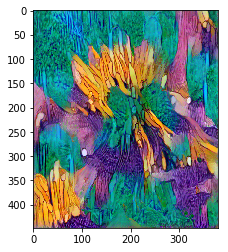

Total loss:  74022.0
ii:  41600


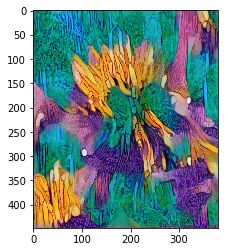

Total loss:  73577.8515625
ii:  42000


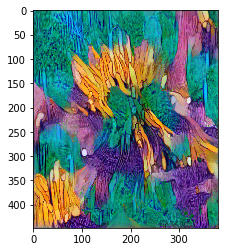

Total loss:  75507.78125
ii:  42400


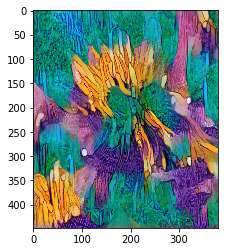

Total loss:  73639.921875
ii:  42800


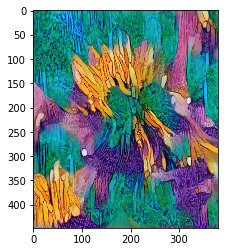

Total loss:  73275.5078125
ii:  43200


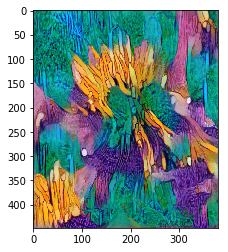

Total loss:  73031.9921875
ii:  43600


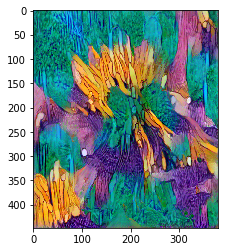

Total loss:  73315.8828125
ii:  44000


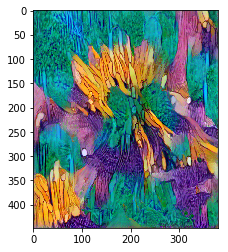

Total loss:  73008.4296875
ii:  44400


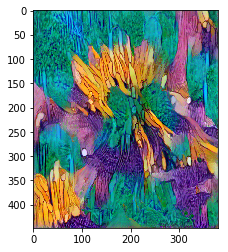

Total loss:  72673.25
ii:  44800


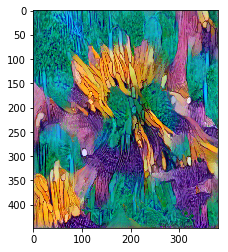

Total loss:  72603.0703125
ii:  45200


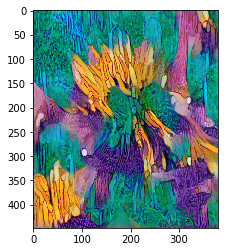

Total loss:  72446.859375
ii:  45600


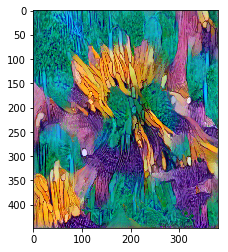

Total loss:  72306.03125
ii:  46000


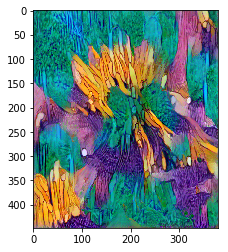

Total loss:  72413.7265625
ii:  46400


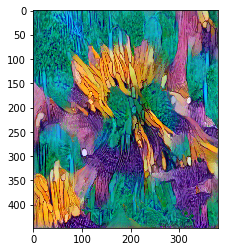

Total loss:  72815.9375
ii:  46800


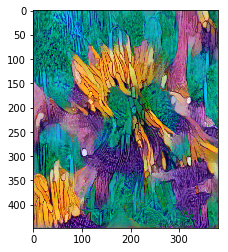

Total loss:  72003.8359375
ii:  47200


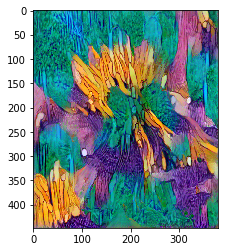

Total loss:  71819.4765625
ii:  47600


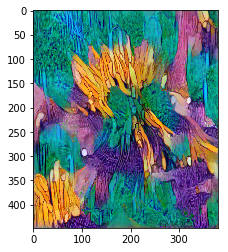

Total loss:  71719.0234375
ii:  48000


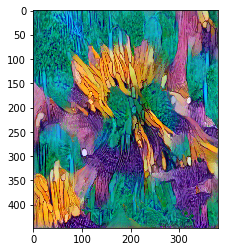

Total loss:  71622.078125
ii:  48400


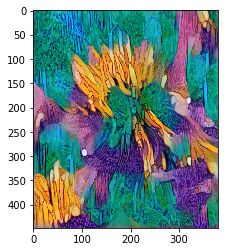

Total loss:  71551.5703125
ii:  48800


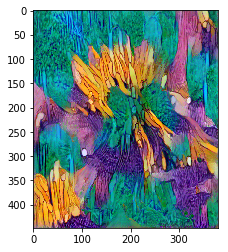

Total loss:  71436.328125
ii:  49200


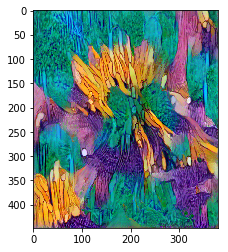

Total loss:  71332.984375
ii:  49600


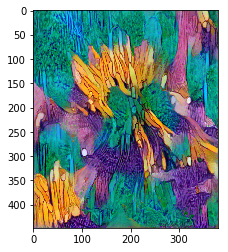

Total loss:  71553.5625
ii:  50000


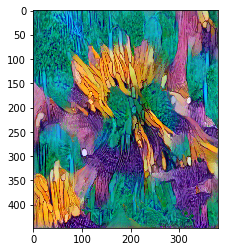

In [14]:
# for displaying the target image, intermittently
show_every = 400 #original 400

# iteration hyperparameters
optimizer = optim.Adam([target], lr=0.003)
steps = 50000  # original 2000; decide how many iterations to update your image (5000)

for ii in range(1, steps+1):
    
    # get the features from your target image
    target_features = get_features(target, vgg)
    
    # the content loss
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    # the style loss
    # initialize the style loss to 0
    style_loss = 0
    # then add to it for each layer's gram matrix loss
    for layer in style_weights:
        # get the "target" style representation for the layer
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        _, d, h, w = target_feature.shape
        # get the "style" style representation
        style_gram = style_grams[layer]
        # the style loss for one layer, weighted appropriately
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        # add to the style loss
        style_loss += layer_style_loss / (d * h * w)
        
    # calculate the *total* loss
    total_loss = content_weight * content_loss + style_weight * style_loss
    
    # update your target image
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # display intermediate images and print the loss
    if  ii % show_every == 0:
        print('Total loss: ', total_loss.item())
        print('ii: ', ii)
        plt.imshow(im_convert(target))
        plt.show()
        # save_image(im_convert(target), 'ru_' + steps + '.jpg')

## Display the Target Image

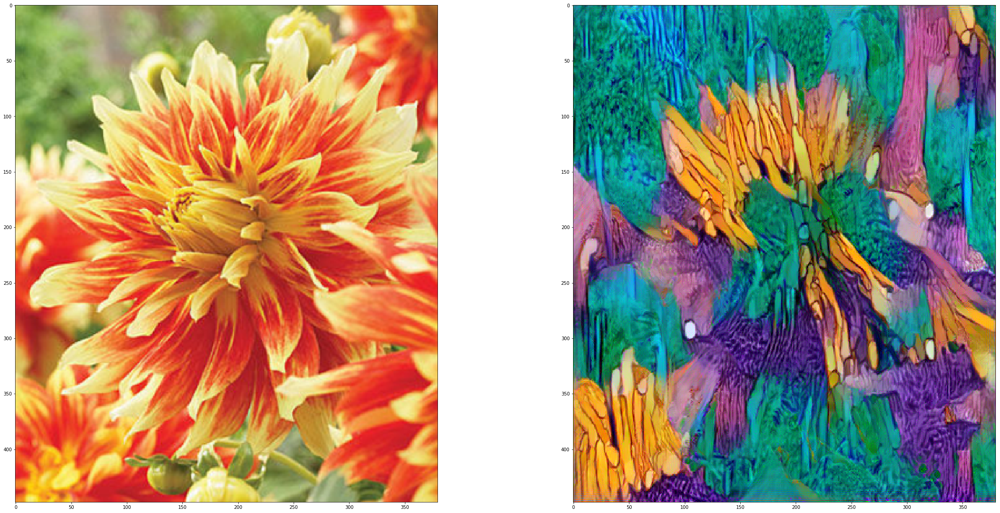

In [15]:
# display content and final, target image
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(40, 20))
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(target))